In [1]:
import sys
import random
import warnings
import numpy as np

from glob import glob
from tqdm import tqdm
import matplotlib.pyplot as plt
from IPython import display
import cv2
import os
import random
import time
import shutil
from sklearn.utils import shuffle
#from libtiff import TIFF
import glob
%matplotlib inline

IMG_WIDTH = 512
IMG_HEIGHT = 512
IMG_CHANNELS = 3
TRAIN_PATH = "./Drive/training/images/"
TEST_PATH = "./Drive/training/1st_manual/"
FINAL_TEST_PATH = "./Drive/test/images/"

dir_path = ""

warnings.filterwarnings("ignore", category = UserWarning, module = "skimage")
seed = 42
random.seed = seed
np.random.seed = seed

print(np.version.version)

1.19.5


In [2]:
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def conv_block(inputs, num_filters):
    x = Conv2D(num_filters, 3, padding = "same")(inputs)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding = "same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x

def decoder_block(inputs, skip, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides = 2, padding = "same")(inputs)
    x = Concatenate()([x, skip])
    x = conv_block(x, num_filters)
    return x

def build_effienet_unet(input_shape):
    """ Input """
    inputs = Input(input_shape)
    
    """ Pre-trained Encoder """
    encoder = EfficientNetB0(include_top = False, weights = "imagenet", input_tensor = inputs)
    #encoder.summary()

    s1 = encoder.get_layer("input_1").output                      ## 256
    s2 = encoder.get_layer("block2a_expand_activation").output    ## 128
    s3 = encoder.get_layer("block3a_expand_activation").output    ## 64
    s4 = encoder.get_layer("block4a_expand_activation").output    ## 32

    """ Bottleneck """
    b1 = encoder.get_layer("block6a_expand_activation").output    ## 16

    """ Decoder """
    d1 = decoder_block(b1, s4, 512)                               ## 32
    d2 = decoder_block(d1, s3, 256)                               ## 64
    d3 = decoder_block(d2, s2, 128)                               ## 128
    d4 = decoder_block(d3, s1, 64)                                ## 256

    """ Output """
    outputs = Conv2D(1, 1, padding = "same", activation = "sigmoid")(d4)

    model = Model([inputs], [outputs], name = "EfficientNetB0_Unet")
    model.compile(optimizer = "adam", loss = "binary_crossentropy", metrics=["accuracy"])

    return model

2021-08-19 13:41:09.973469: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


In [3]:
# Get train and test IDs

def getPath(path, file):

    image_list = []

    for filename in glob.glob(path + "*" + file): #assuming gif

        image_list.append(filename)

    return image_list

train_ids = sorted(getPath(TRAIN_PATH, ".tif"))
test_ids = sorted(getPath(TEST_PATH, ".gif"))
final_test_ids = sorted(getPath(FINAL_TEST_PATH, ".tif"))

In [4]:
# Get and resize train images and masks
X_train = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
Y_train = np.zeros((len(test_ids), IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
print("Getting and resizing train images and masks ... ")

Getting and resizing train images and masks ... 


  0%|                                                                                                                                                                                                                                                      | 0/20 [00:00<?, ?it/s]

valor 0
Dados : 
 ImagePath : ./Drive/training/images/21_training.tif

imagem dim : (512, 512, 3)


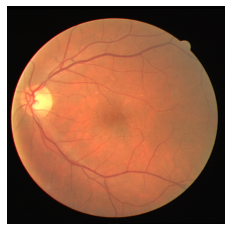

Dados : 
 GTPath : ./Drive/training/1st_manual/21_manual1.gif

Dim Gr : (512, 512, 1)


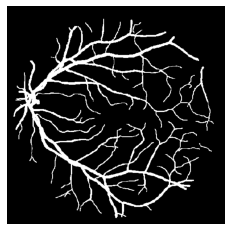

  5%|███████████▉                                                                                                                                                                                                                                  | 1/20 [00:00<00:05,  3.69it/s]

valor 1
Dados : 
 ImagePath : ./Drive/training/images/22_training.tif

imagem dim : (512, 512, 3)


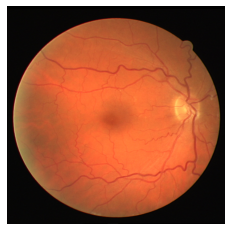

Dados : 
 GTPath : ./Drive/training/1st_manual/22_manual1.gif

Dim Gr : (512, 512, 1)


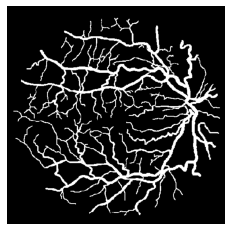

 10%|███████████████████████▊                                                                                                                                                                                                                      | 2/20 [00:00<00:04,  3.97it/s]

valor 2
Dados : 
 ImagePath : ./Drive/training/images/23_training.tif

imagem dim : (512, 512, 3)


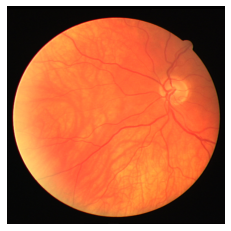

Dados : 
 GTPath : ./Drive/training/1st_manual/23_manual1.gif

Dim Gr : (512, 512, 1)


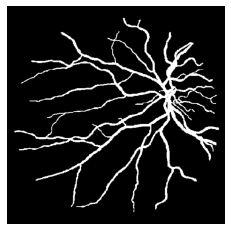

 15%|███████████████████████████████████▋                                                                                                                                                                                                          | 3/20 [00:00<00:04,  4.17it/s]

valor 3
Dados : 
 ImagePath : ./Drive/training/images/24_training.tif

imagem dim : (512, 512, 3)


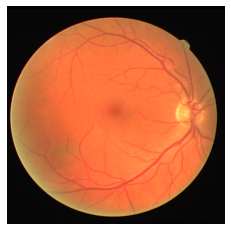

Dados : 
 GTPath : ./Drive/training/1st_manual/24_manual1.gif

Dim Gr : (512, 512, 1)


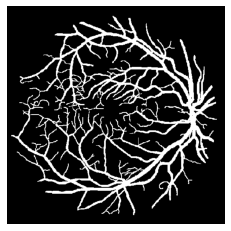

 20%|███████████████████████████████████████████████▌                                                                                                                                                                                              | 4/20 [00:00<00:03,  4.40it/s]

valor 4
Dados : 
 ImagePath : ./Drive/training/images/25_training.tif

imagem dim : (512, 512, 3)


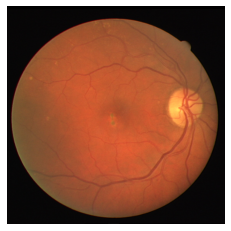

Dados : 
 GTPath : ./Drive/training/1st_manual/25_manual1.gif

Dim Gr : (512, 512, 1)


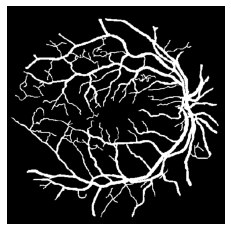

 25%|███████████████████████████████████████████████████████████▌                                                                                                                                                                                  | 5/20 [00:01<00:03,  4.08it/s]

valor 5
Dados : 
 ImagePath : ./Drive/training/images/26_training.tif

imagem dim : (512, 512, 3)


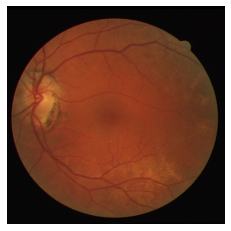

Dados : 
 GTPath : ./Drive/training/1st_manual/26_manual1.gif

Dim Gr : (512, 512, 1)


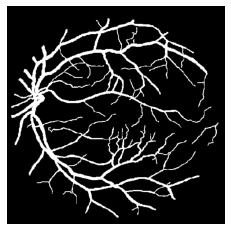

 30%|███████████████████████████████████████████████████████████████████████▍                                                                                                                                                                      | 6/20 [00:01<00:03,  4.08it/s]

valor 6
Dados : 
 ImagePath : ./Drive/training/images/27_training.tif

imagem dim : (512, 512, 3)


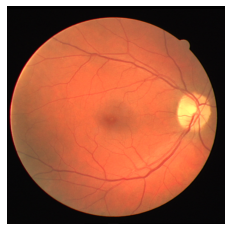

Dados : 
 GTPath : ./Drive/training/1st_manual/27_manual1.gif

Dim Gr : (512, 512, 1)


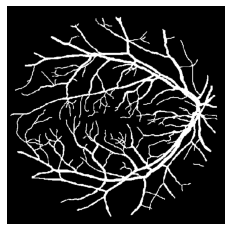

 35%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                          | 7/20 [00:01<00:03,  4.29it/s]

valor 7
Dados : 
 ImagePath : ./Drive/training/images/28_training.tif

imagem dim : (512, 512, 3)


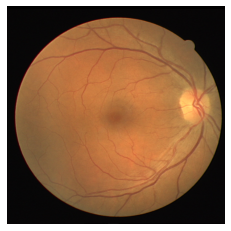

Dados : 
 GTPath : ./Drive/training/1st_manual/28_manual1.gif

Dim Gr : (512, 512, 1)


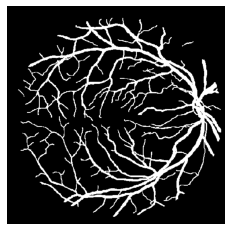

 40%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                              | 8/20 [00:01<00:02,  4.11it/s]

valor 8
Dados : 
 ImagePath : ./Drive/training/images/29_training.tif

imagem dim : (512, 512, 3)


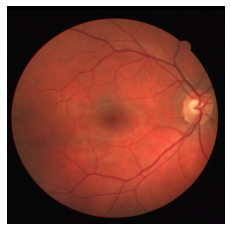

Dados : 
 GTPath : ./Drive/training/1st_manual/29_manual1.gif

Dim Gr : (512, 512, 1)


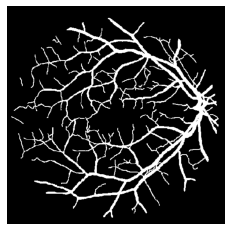

 45%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                   | 9/20 [00:02<00:02,  4.27it/s]

valor 9
Dados : 
 ImagePath : ./Drive/training/images/30_training.tif

imagem dim : (512, 512, 3)


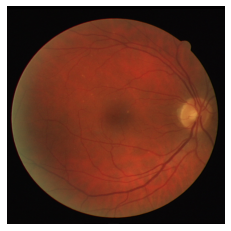

Dados : 
 GTPath : ./Drive/training/1st_manual/30_manual1.gif

Dim Gr : (512, 512, 1)


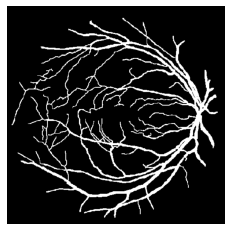

 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                      | 10/20 [00:02<00:02,  4.42it/s]

valor 10
Dados : 
 ImagePath : ./Drive/training/images/31_training.tif

imagem dim : (512, 512, 3)


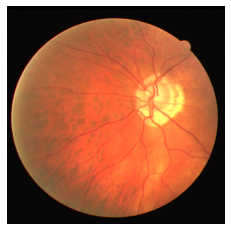

Dados : 
 GTPath : ./Drive/training/1st_manual/31_manual1.gif

Dim Gr : (512, 512, 1)


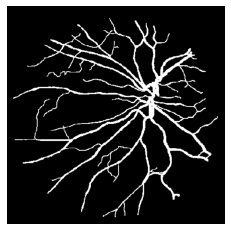

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                          | 11/20 [00:02<00:02,  4.49it/s]

valor 11
Dados : 
 ImagePath : ./Drive/training/images/32_training.tif

imagem dim : (512, 512, 3)


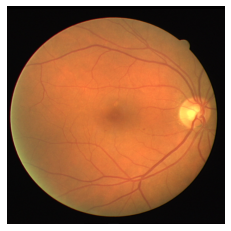

Dados : 
 GTPath : ./Drive/training/1st_manual/32_manual1.gif

Dim Gr : (512, 512, 1)


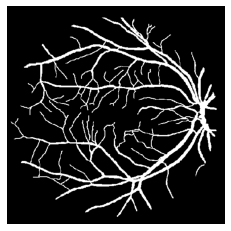

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                              | 12/20 [00:02<00:01,  4.43it/s]

valor 12
Dados : 
 ImagePath : ./Drive/training/images/33_training.tif

imagem dim : (512, 512, 3)


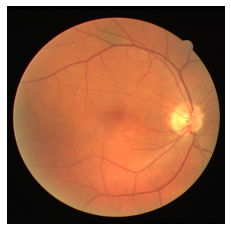

Dados : 
 GTPath : ./Drive/training/1st_manual/33_manual1.gif

Dim Gr : (512, 512, 1)


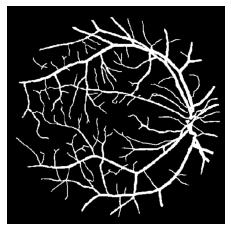

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                   | 13/20 [00:03<00:01,  4.54it/s]

valor 13
Dados : 
 ImagePath : ./Drive/training/images/34_training.tif

imagem dim : (512, 512, 3)


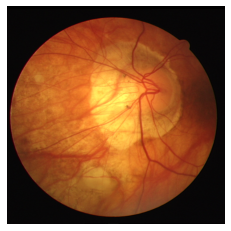

Dados : 
 GTPath : ./Drive/training/1st_manual/34_manual1.gif

Dim Gr : (512, 512, 1)


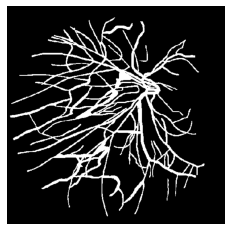

 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 14/20 [00:03<00:01,  4.63it/s]

valor 14
Dados : 
 ImagePath : ./Drive/training/images/35_training.tif

imagem dim : (512, 512, 3)


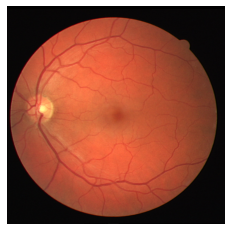

Dados : 
 GTPath : ./Drive/training/1st_manual/35_manual1.gif

Dim Gr : (512, 512, 1)


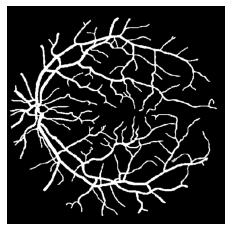

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 15/20 [00:03<00:01,  4.71it/s]

valor 15
Dados : 
 ImagePath : ./Drive/training/images/36_training.tif

imagem dim : (512, 512, 3)


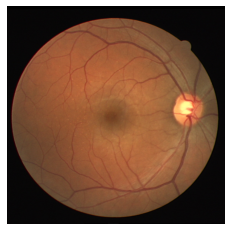

Dados : 
 GTPath : ./Drive/training/1st_manual/36_manual1.gif

Dim Gr : (512, 512, 1)


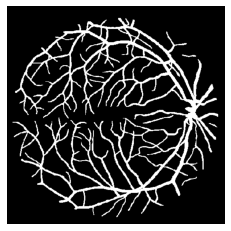

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 16/20 [00:03<00:00,  4.70it/s]

valor 16
Dados : 
 ImagePath : ./Drive/training/images/37_training.tif

imagem dim : (512, 512, 3)


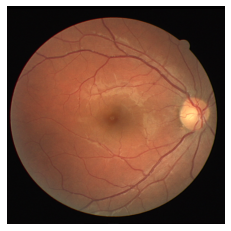

Dados : 
 GTPath : ./Drive/training/1st_manual/37_manual1.gif

Dim Gr : (512, 512, 1)


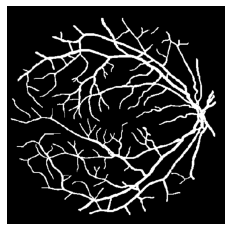

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 17/20 [00:03<00:00,  4.78it/s]

valor 17
Dados : 
 ImagePath : ./Drive/training/images/38_training.tif

imagem dim : (512, 512, 3)


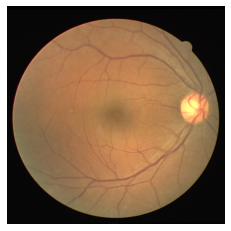

Dados : 
 GTPath : ./Drive/training/1st_manual/38_manual1.gif

Dim Gr : (512, 512, 1)


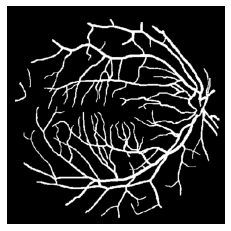

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 18/20 [00:04<00:00,  4.82it/s]

valor 18
Dados : 
 ImagePath : ./Drive/training/images/39_training.tif

imagem dim : (512, 512, 3)


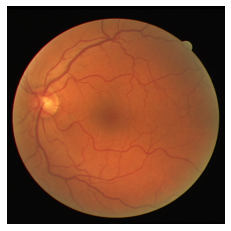

Dados : 
 GTPath : ./Drive/training/1st_manual/39_manual1.gif

Dim Gr : (512, 512, 1)


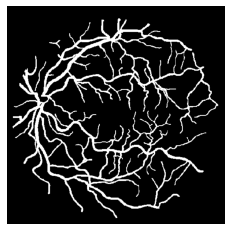

 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 19/20 [00:04<00:00,  4.35it/s]

valor 19
Dados : 
 ImagePath : ./Drive/training/images/40_training.tif

imagem dim : (512, 512, 3)


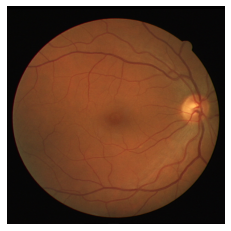

Dados : 
 GTPath : ./Drive/training/1st_manual/40_manual1.gif

Dim Gr : (512, 512, 1)


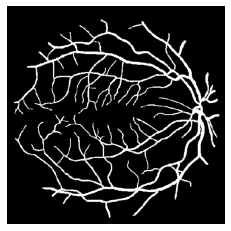

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.41it/s]

Getting and resizing test images ... 



  0%|                                                                                                                                                                                                                                                      | 0/20 [00:00<?, ?it/s]

Dados : 
 ImagePath : ./Drive/test/images/01_test.tif

imagem dim : (512, 512, 3)


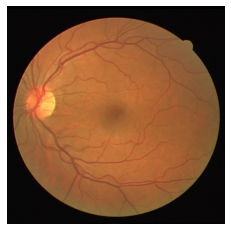

  5%|███████████▉                                                                                                                                                                                                                                  | 1/20 [00:00<00:02,  7.42it/s]

Dados : 
 ImagePath : ./Drive/test/images/02_test.tif

imagem dim : (512, 512, 3)


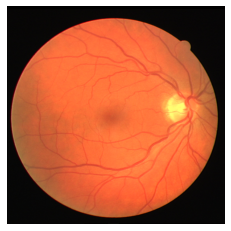

 10%|███████████████████████▊                                                                                                                                                                                                                      | 2/20 [00:00<00:02,  7.32it/s]

Dados : 
 ImagePath : ./Drive/test/images/03_test.tif

imagem dim : (512, 512, 3)


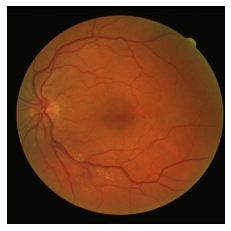

 15%|███████████████████████████████████▋                                                                                                                                                                                                          | 3/20 [00:00<00:02,  7.45it/s]

Dados : 
 ImagePath : ./Drive/test/images/04_test.tif

imagem dim : (512, 512, 3)


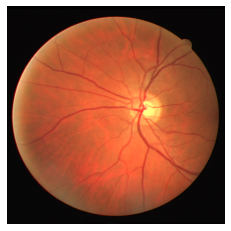

 20%|███████████████████████████████████████████████▌                                                                                                                                                                                              | 4/20 [00:00<00:02,  7.41it/s]

Dados : 
 ImagePath : ./Drive/test/images/05_test.tif

imagem dim : (512, 512, 3)


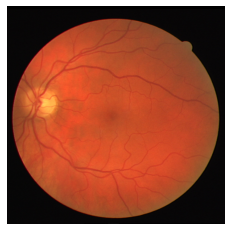

 25%|███████████████████████████████████████████████████████████▌                                                                                                                                                                                  | 5/20 [00:00<00:02,  7.36it/s]

Dados : 
 ImagePath : ./Drive/test/images/06_test.tif

imagem dim : (512, 512, 3)


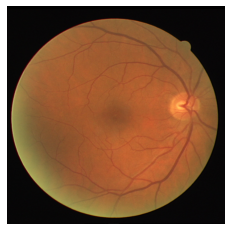

 30%|███████████████████████████████████████████████████████████████████████▍                                                                                                                                                                      | 6/20 [00:00<00:01,  7.35it/s]

Dados : 
 ImagePath : ./Drive/test/images/07_test.tif

imagem dim : (512, 512, 3)


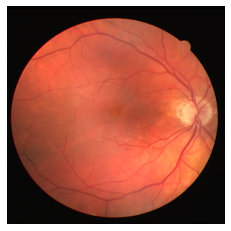

 35%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                          | 7/20 [00:00<00:01,  7.31it/s]

Dados : 
 ImagePath : ./Drive/test/images/08_test.tif

imagem dim : (512, 512, 3)


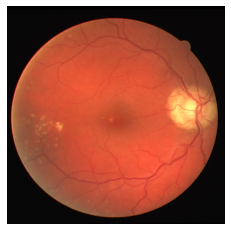

 40%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                              | 8/20 [00:01<00:01,  7.21it/s]

Dados : 
 ImagePath : ./Drive/test/images/09_test.tif

imagem dim : (512, 512, 3)


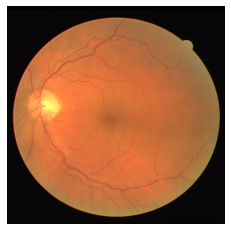

 45%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                   | 9/20 [00:01<00:01,  7.26it/s]

Dados : 
 ImagePath : ./Drive/test/images/10_test.tif

imagem dim : (512, 512, 3)


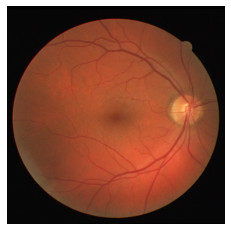

 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                      | 10/20 [00:01<00:01,  7.28it/s]

Dados : 
 ImagePath : ./Drive/test/images/11_test.tif

imagem dim : (512, 512, 3)


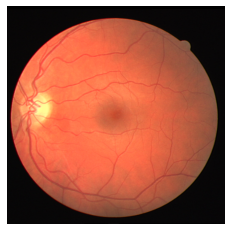

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                          | 11/20 [00:01<00:01,  7.36it/s]

Dados : 
 ImagePath : ./Drive/test/images/12_test.tif

imagem dim : (512, 512, 3)


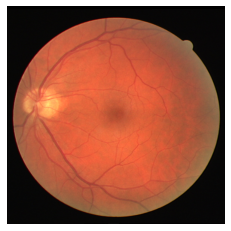

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                              | 12/20 [00:01<00:01,  7.10it/s]

Dados : 
 ImagePath : ./Drive/test/images/13_test.tif

imagem dim : (512, 512, 3)


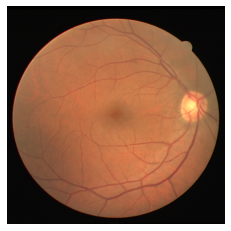

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                   | 13/20 [00:01<00:00,  7.17it/s]

Dados : 
 ImagePath : ./Drive/test/images/14_test.tif

imagem dim : (512, 512, 3)


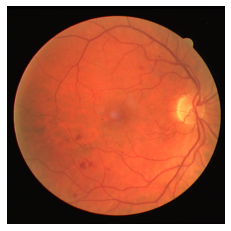

 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 14/20 [00:01<00:00,  7.20it/s]

Dados : 
 ImagePath : ./Drive/test/images/15_test.tif

imagem dim : (512, 512, 3)


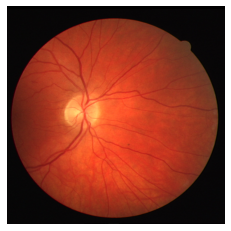

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 15/20 [00:02<00:00,  7.21it/s]

Dados : 
 ImagePath : ./Drive/test/images/16_test.tif

imagem dim : (512, 512, 3)


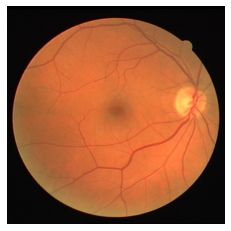

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 16/20 [00:02<00:00,  7.26it/s]

Dados : 
 ImagePath : ./Drive/test/images/17_test.tif

imagem dim : (512, 512, 3)


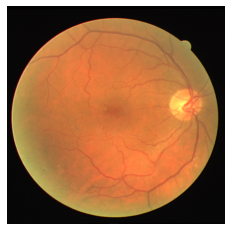

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 17/20 [00:02<00:00,  7.24it/s]

Dados : 
 ImagePath : ./Drive/test/images/18_test.tif

imagem dim : (512, 512, 3)


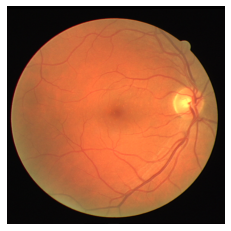

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 18/20 [00:02<00:00,  6.32it/s]

Dados : 
 ImagePath : ./Drive/test/images/19_test.tif

imagem dim : (512, 512, 3)


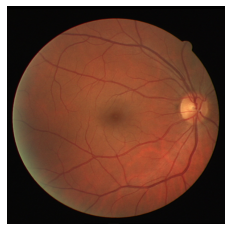

 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 19/20 [00:02<00:00,  6.59it/s]

Dados : 
 ImagePath : ./Drive/test/images/20_test.tif

imagem dim : (512, 512, 3)


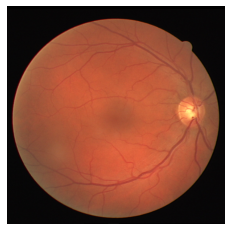

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  7.10it/s]

Done!


In [5]:
import imageio
from tifffile import imread, imwrite
from skimage.transform import resize

sys.stdout.flush()
for n, id_ in tqdm(enumerate(train_ids), total=len(train_ids)):

    print("valor {}".format(n))
    
    print("Dados : \n ImagePath : {}\n".format(id_))
    #image = Image.open(id_)
    image = imread(id_)[:,:,:IMG_CHANNELS]
    image = resize(image, (IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS), mode = "constant", preserve_range = True)

    print("imagem dim : {}".format(image.shape))
    X_train[n] = image

    plt.axis("off")
    plt.imshow(X_train[n])
    plt.show()

    gif = imageio.get_reader(test_ids[n], ".gif")
    print("Dados : \n GTPath : {}\n".format(test_ids[n]))
    groundtruth = []
    for frame in gif:

      groundtruth = frame

    groundtruth=np.where(groundtruth>0,1,0)
    mask = np.zeros((IMG_HEIGHT, IMG_WIDTH, 1), dtype = np.bool)
    
    #Expand individual mask dimensions
    mask_ = np.expand_dims(resize(groundtruth, (IMG_HEIGHT, IMG_WIDTH), mode = "constant",
                                      preserve_range = True), axis = -1)

    mask = np.maximum(mask, mask_)
    Y_train[n] = mask

    print("Dim Gr : {}".format(mask.shape))
    
    plt.axis("off")
    plt.imshow(Y_train[n], cmap = plt.cm.gray)
    plt.show()

X_test = np.zeros((len(test_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype = np.uint8)
sizes_test = []
print("Getting and resizing test images ... ")
sys.stdout.flush()

for n, id_ in tqdm(enumerate(final_test_ids), total = len(final_test_ids)):

    print("Dados : \n ImagePath : {}\n".format(id_))
    image = imread(id_)[:,:,:IMG_CHANNELS]
    image = resize(image, (IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS), mode = "constant", preserve_range = True)
    print("imagem dim : {}".format(image.shape))
    X_test[n] = image

    plt.axis("off")
    plt.imshow(X_test[n], cmap = plt.cm.gray)
    plt.show()

    sizes_test.append([image.shape[0], image.shape[1]])

print("Done!")

In [6]:
model = build_effienet_unet((IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS))
model.summary()

2021-08-19 13:41:18.414200: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-08-19 13:41:18.446796: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-19 13:41:18.447207: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1070 computeCapability: 6.1
coreClock: 1.86GHz coreCount: 15 deviceMemorySize: 7.91GiB deviceMemoryBandwidth: 238.66GiB/s
2021-08-19 13:41:18.447240: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-08-19 13:41:18.449516: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublas.so.11
2021-08-19 13:41:18.449567: I tensorflow/stream_executor/platform/de

Model: "EfficientNetB0_Unet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 512, 512, 3) 0                                            
__________________________________________________________________________________________________
rescaling (Rescaling)           (None, 512, 512, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
normalization (Normalization)   (None, 512, 512, 3)  7           rescaling[0][0]                  
__________________________________________________________________________________________________
stem_conv_pad (ZeroPadding2D)   (None, 513, 513, 3)  0           normalization[0][0]              
________________________________________________________________________________

In [7]:
# Fit model
earlystopper = EarlyStopping(patience = 15, verbose = 1)
checkpointer = ModelCheckpoint("model_unet_checkpoint.h5", verbose = 1, save_best_only = True)
results = model.fit(X_train, Y_train, validation_split = 0.1, batch_size = 1, epochs = 200,
                    callbacks=[checkpointer])
model.save("modelEffNetDrive.h5")

2021-08-19 13:41:20.233708: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:176] None of the MLIR Optimization Passes are enabled (registered 2)
2021-08-19 13:41:20.251575: I tensorflow/core/platform/profile_utils/cpu_utils.cc:114] CPU Frequency: 3999980000 Hz


Epoch 1/200


2021-08-19 13:41:24.160242: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudnn.so.8
2021-08-19 13:41:24.385357: I tensorflow/stream_executor/cuda/cuda_dnn.cc:359] Loaded cuDNN version 8101
2021-08-19 13:41:24.618434: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublas.so.11
2021-08-19 13:41:24.793373: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublasLt.so.11


18/18 [==============================] - 11s 225ms/step - loss: 0.4536 - accuracy: 0.8310 - val_loss: 0.5256 - val_accuracy: 0.8492

Epoch 00001: val_loss improved from inf to 0.52561, saving model to model_unet_checkpoint.h5


/home/borin/anaconda3/envs/IcFlorindo/lib/python3.8/site-packages/tensorflow/python/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Epoch 2/200
18/18 [==============================] - 3s 181ms/step - loss: 0.2159 - accuracy: 0.9449 - val_loss: 1.3918 - val_accuracy: 0.8929

Epoch 00002: val_loss did not improve from 0.52561
Epoch 3/200
18/18 [==============================] - 3s 181ms/step - loss: 0.1753 - accuracy: 0.9500 - val_loss: 5.3745 - val_accuracy: 0.5685

Epoch 00003: val_loss did not improve from 0.52561
Epoch 4/200
18/18 [==============================] - 3s 181ms/step - loss: 0.1545 - accuracy: 0.9530 - val_loss: 1.8371 - val_accuracy: 0.6810

Epoch 00004: val_loss did not improve from 0.52561
Epoch 5/200
18/18 [==============================] - 3s 181ms/step - loss: 0.1377 - accuracy: 0.9568 - val_loss: 0.5610 - val_accuracy: 0.8766

Epoch 00005: val_loss did not improve from 0.52561
Epoch 6/200
18/18 [==============================] - 3s 180ms/step - loss: 0.1246 - accuracy: 0.9596 - val_loss: 0.5209 - val_accuracy: 0.8818

Epoch 00006: val_loss improved from 0.52561 to 0.52092, saving model to mode


Epoch 00042: val_loss did not improve from 0.13136
Epoch 43/200
18/18 [==============================] - 3s 181ms/step - loss: 0.0277 - accuracy: 0.9892 - val_loss: 0.1540 - val_accuracy: 0.9545

Epoch 00043: val_loss did not improve from 0.13136
Epoch 44/200
18/18 [==============================] - 3s 182ms/step - loss: 0.0253 - accuracy: 0.9902 - val_loss: 0.1512 - val_accuracy: 0.9579

Epoch 00044: val_loss did not improve from 0.13136
Epoch 45/200
18/18 [==============================] - 3s 181ms/step - loss: 0.0241 - accuracy: 0.9906 - val_loss: 0.1611 - val_accuracy: 0.9539

Epoch 00045: val_loss did not improve from 0.13136
Epoch 46/200
18/18 [==============================] - 3s 181ms/step - loss: 0.0260 - accuracy: 0.9898 - val_loss: 0.1488 - val_accuracy: 0.9574

Epoch 00046: val_loss did not improve from 0.13136
Epoch 47/200
18/18 [==============================] - 3s 181ms/step - loss: 0.0238 - accuracy: 0.9907 - val_loss: 0.1688 - val_accuracy: 0.9545

Epoch 00047: val_lo


Epoch 00084: val_loss did not improve from 0.13136
Epoch 85/200
18/18 [==============================] - 3s 176ms/step - loss: 0.0075 - accuracy: 0.9974 - val_loss: 0.2011 - val_accuracy: 0.9589

Epoch 00085: val_loss did not improve from 0.13136
Epoch 86/200
18/18 [==============================] - 3s 180ms/step - loss: 0.0078 - accuracy: 0.9972 - val_loss: 0.2051 - val_accuracy: 0.9587

Epoch 00086: val_loss did not improve from 0.13136
Epoch 87/200
18/18 [==============================] - 3s 178ms/step - loss: 0.0084 - accuracy: 0.9969 - val_loss: 0.2053 - val_accuracy: 0.9592

Epoch 00087: val_loss did not improve from 0.13136
Epoch 88/200
18/18 [==============================] - 3s 184ms/step - loss: 0.0068 - accuracy: 0.9977 - val_loss: 0.2047 - val_accuracy: 0.9595

Epoch 00088: val_loss did not improve from 0.13136
Epoch 89/200
18/18 [==============================] - 3s 186ms/step - loss: 0.0062 - accuracy: 0.9979 - val_loss: 0.2190 - val_accuracy: 0.9583

Epoch 00089: val_lo

18/18 [==============================] - 3s 183ms/step - loss: 0.0105 - accuracy: 0.9962 - val_loss: 0.2509 - val_accuracy: 0.9586

Epoch 00126: val_loss did not improve from 0.13136
Epoch 127/200
18/18 [==============================] - 3s 182ms/step - loss: 0.0071 - accuracy: 0.9973 - val_loss: 0.2738 - val_accuracy: 0.9566

Epoch 00127: val_loss did not improve from 0.13136
Epoch 128/200
18/18 [==============================] - 3s 176ms/step - loss: 0.0053 - accuracy: 0.9981 - val_loss: 0.2692 - val_accuracy: 0.9587

Epoch 00128: val_loss did not improve from 0.13136
Epoch 129/200
18/18 [==============================] - 3s 174ms/step - loss: 0.0035 - accuracy: 0.9989 - val_loss: 0.2655 - val_accuracy: 0.9578

Epoch 00129: val_loss did not improve from 0.13136
Epoch 130/200
18/18 [==============================] - 3s 177ms/step - loss: 0.0023 - accuracy: 0.9994 - val_loss: 0.2549 - val_accuracy: 0.9593

Epoch 00130: val_loss did not improve from 0.13136
Epoch 131/200
18/18 [========

18/18 [==============================] - 3s 175ms/step - loss: 0.0037 - accuracy: 0.9987 - val_loss: 0.2702 - val_accuracy: 0.9599

Epoch 00167: val_loss did not improve from 0.13136
Epoch 168/200
18/18 [==============================] - 3s 176ms/step - loss: 0.0029 - accuracy: 0.9990 - val_loss: 0.2861 - val_accuracy: 0.9593

Epoch 00168: val_loss did not improve from 0.13136
Epoch 169/200
18/18 [==============================] - 3s 180ms/step - loss: 0.0034 - accuracy: 0.9988 - val_loss: 0.2907 - val_accuracy: 0.9582

Epoch 00169: val_loss did not improve from 0.13136
Epoch 170/200
18/18 [==============================] - 3s 182ms/step - loss: 0.0029 - accuracy: 0.9990 - val_loss: 0.2843 - val_accuracy: 0.9594

Epoch 00170: val_loss did not improve from 0.13136
Epoch 171/200
18/18 [==============================] - 3s 179ms/step - loss: 0.0029 - accuracy: 0.9990 - val_loss: 0.2939 - val_accuracy: 0.9587

Epoch 00171: val_loss did not improve from 0.13136
Epoch 172/200
18/18 [========

In [8]:
def plot_learning_curve(history):

    plt.figure(figsize = (12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history["accuracy"])
    plt.plot(history.history["val_accuracy"])
    plt.title("acurácia do modelo", fontsize = 20)
    plt.ylabel("acurácia (em %)", fontsize = 16)
    plt.xlabel("época", fontsize = 16)
    plt.legend(["treino", "teste"], loc = "upper left")
    # summarize history for loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history["loss"])
    plt.plot(history.history["val_loss"])
    plt.title("perda do modelo", fontsize = 20)
    plt.ylabel("valor perda", fontsize = 16)
    plt.xlabel("época", fontsize = 16)
    plt.legend(["treino", "teste"], loc = "upper left")
    plt.savefig("./ResultadosPlots/curve_EffUnetDrive.png")

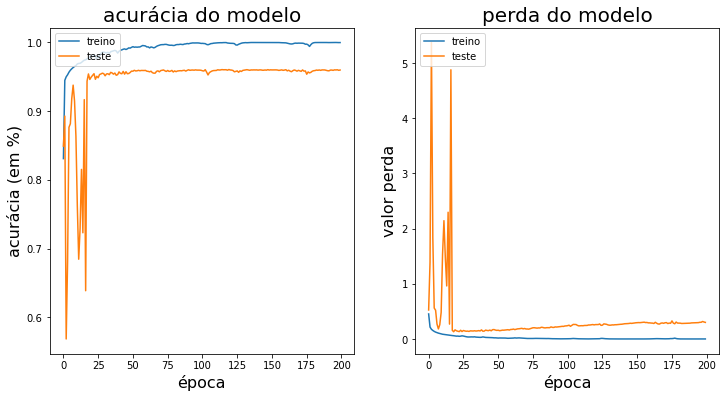

In [9]:
plot_learning_curve(results)
plt.show()

In [10]:
# Predict on train, val and test
#model = load_model("model.h5")
trainLen = len(X_train)
preds_train = model.predict(X_train[:trainLen - 2], verbose = 1)
preds_test = model.predict(X_train[trainLen - 2:], verbose = 1)
preds_val = model.predict(X_test, verbose = 1)

# Threshold predictions
preds_train_t = (preds_train > 0.25).astype(np.uint8)
preds_test_t = (preds_test > 0.25).astype(np.uint8)
preds_val_t = (preds_val > 0.25).astype(np.uint8)

1/1 [==============================] - 14s 14s/step


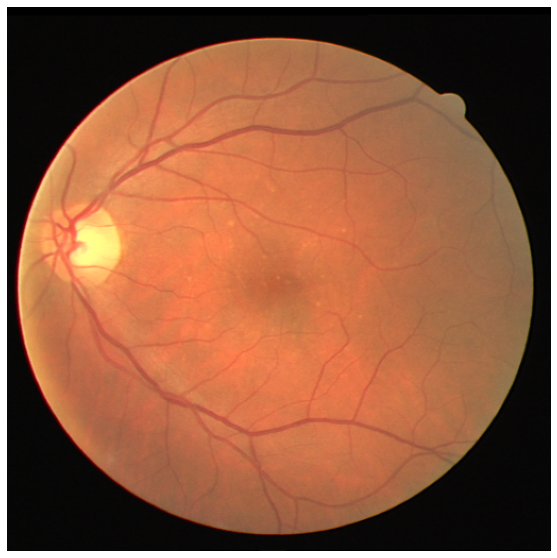

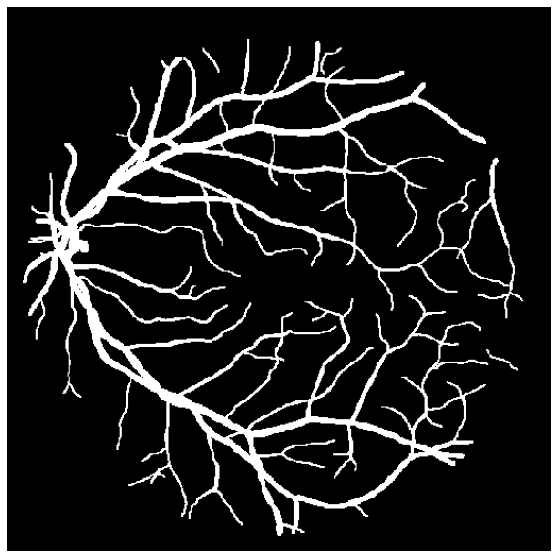

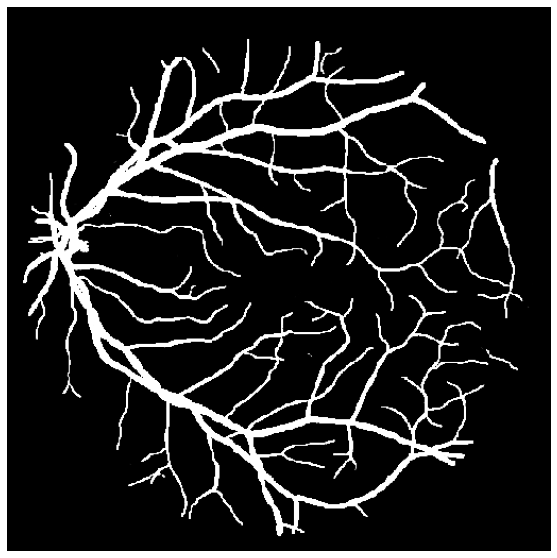

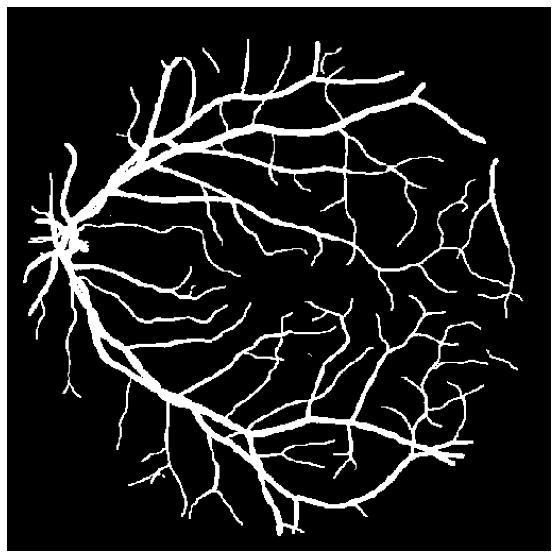

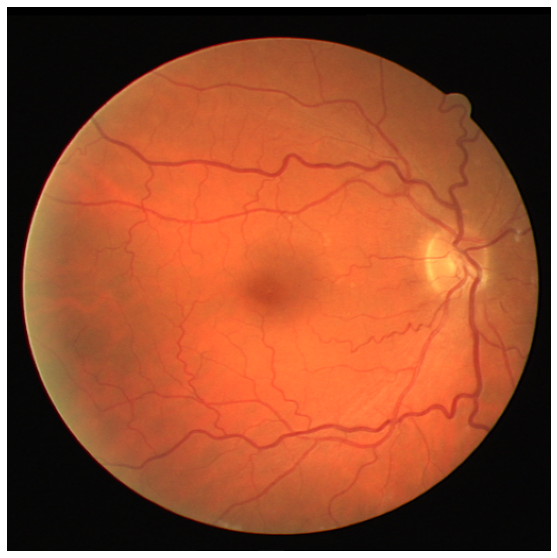

...

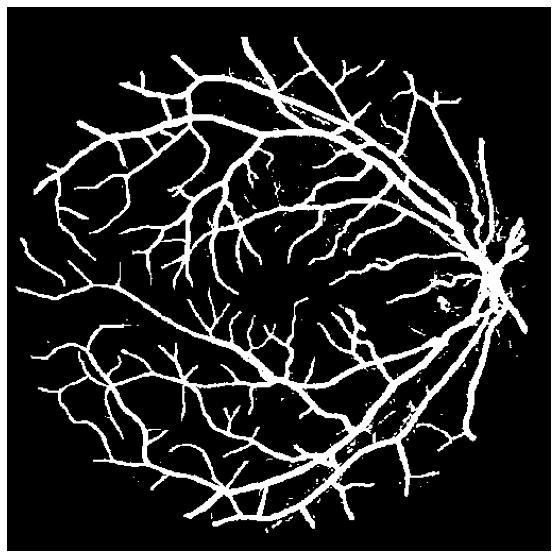

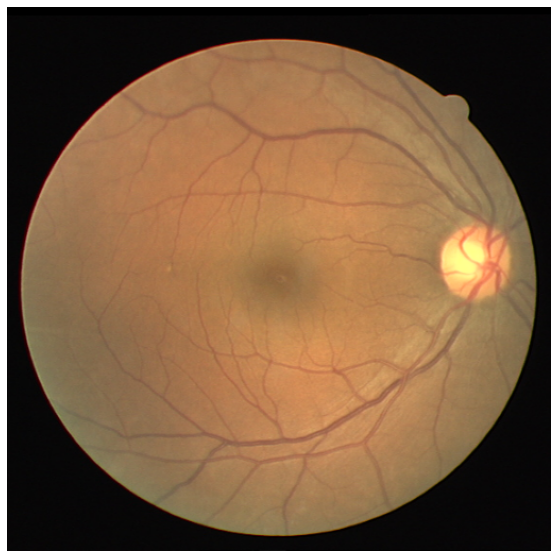

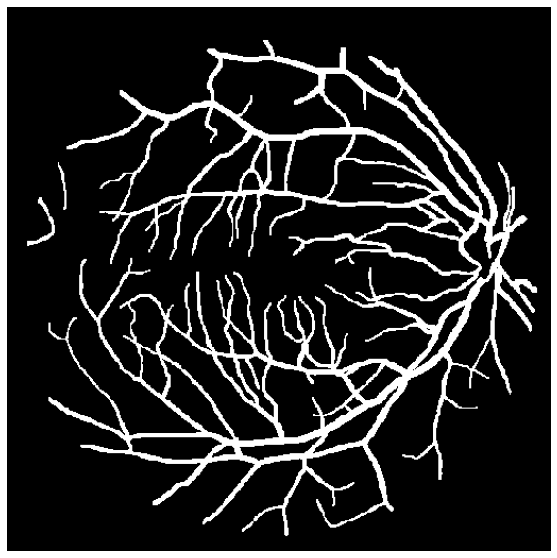

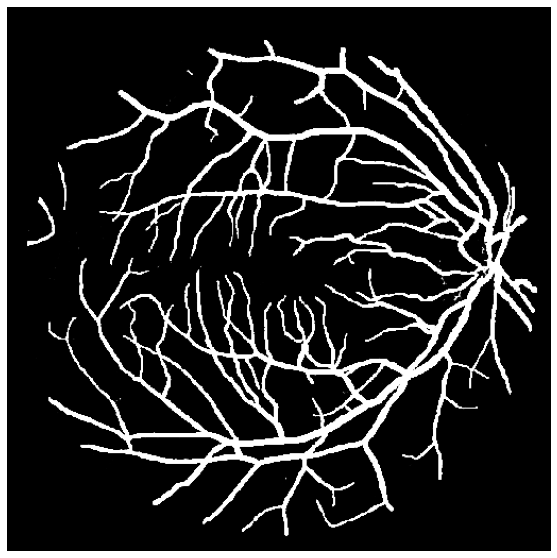

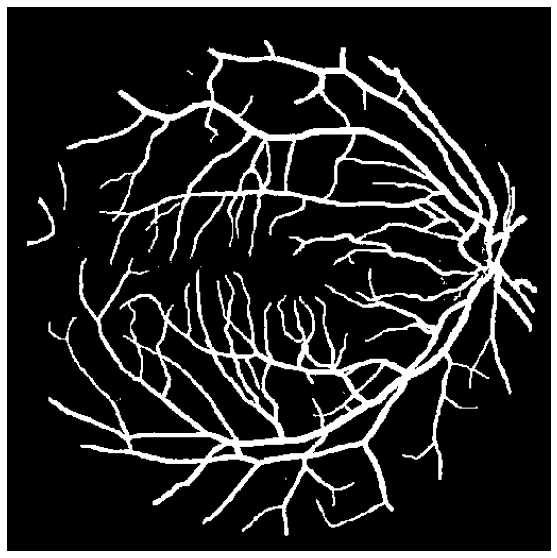

In [11]:
# Treino

lastIndex = 0

for i in range(0, len(preds_train)):

    plt.figure(figsize = (10, 10))
    plt.axis("off")
    plt.imshow(X_train[i])
    plt.savefig("./ResultadosImages/Treino/FigTreino{}.png".format(i))
    plt.show()
    
    plt.figure(figsize = (10, 10))
    plt.axis("off")
    plt.imshow(Y_train[i], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Treino/FigEffUnetTreinoOriginal{}.png".format(i))
    plt.show()

    plt.figure(figsize = (10, 10))
    plt.axis("off")
    plt.imshow(preds_train[i], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Treino/FigEffUnetPrediTreino{}.png".format(i))
    plt.show()

    plt.figure(figsize = (10, 10))
    plt.axis("off")
    plt.imshow(preds_train_t[i], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Treino/FigEffUnetPredTreshiTreino{}.png".format(i))
    plt.show()
    
    lastIndex = i

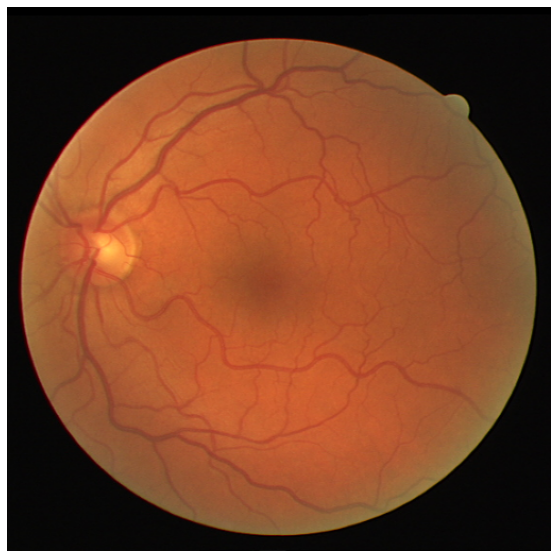

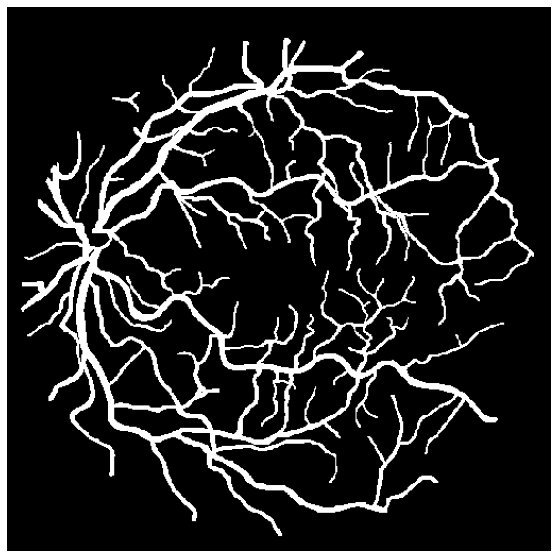

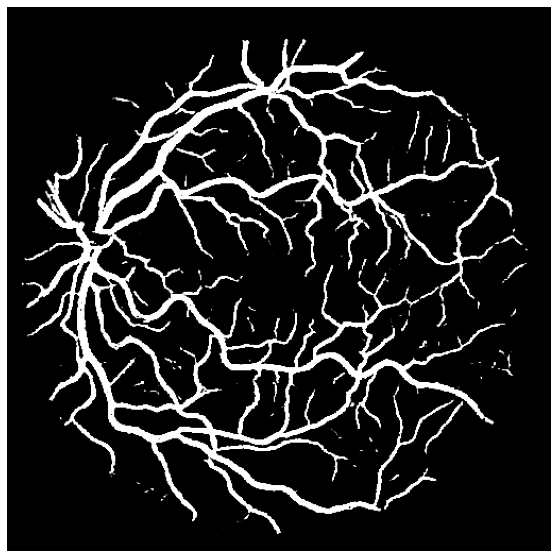

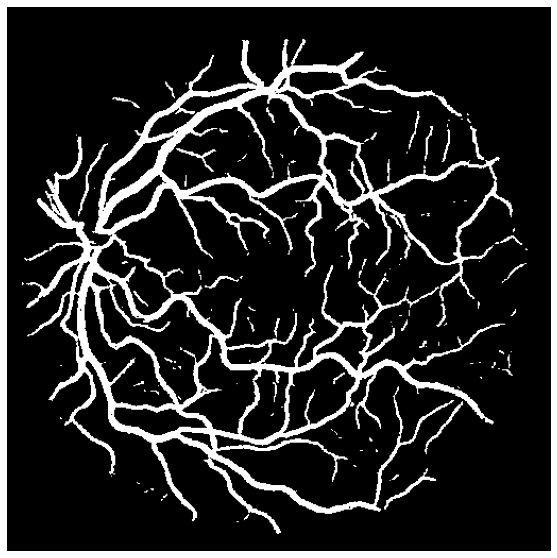

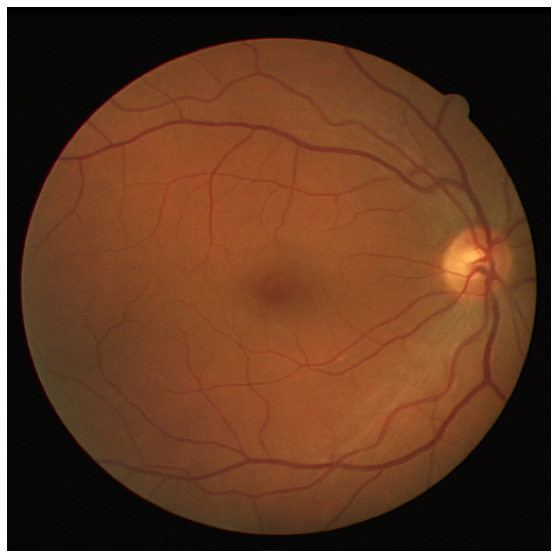

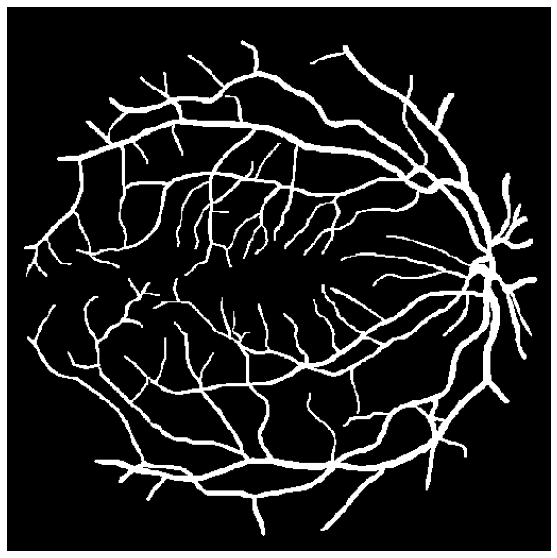

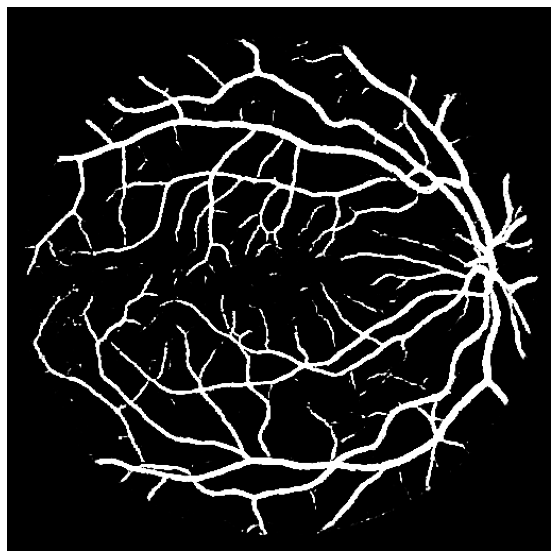

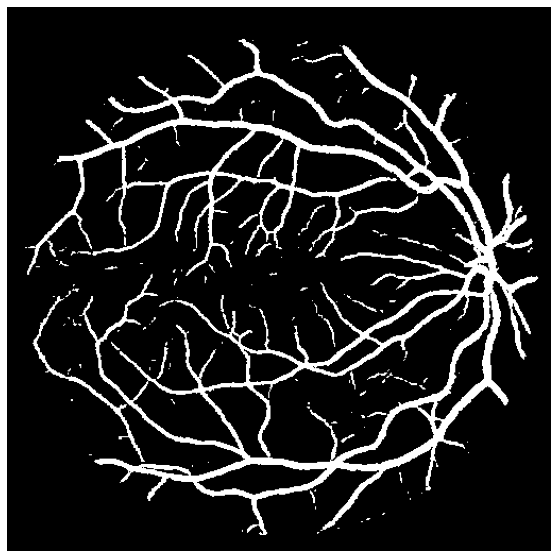

In [12]:
# Teste
for i in range(0, len(preds_test)):

    plt.figure(figsize = (10, 10))
    plt.axis("off")
    plt.imshow(X_train[lastIndex + i + 1])
    plt.savefig("./ResultadosImages/Teste/FigTeste{}.png".format(lastIndex + i + 1))
    plt.show()

    plt.figure(figsize = (10,10))
    plt.axis("off")
    plt.imshow(Y_train[lastIndex + i + 1], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Teste/FigEffUnetTesteOriginal{}.png".format(lastIndex + i + 1))
    plt.show()

    plt.figure(figsize = (10,10))
    plt.axis("off")
    plt.imshow(preds_test[i], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Teste/FigEffUnetPrediTeste{}.png".format(i))
    plt.show()

    plt.figure(figsize = (10, 10))
    plt.axis("off")
    plt.imshow(preds_test_t[i], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Teste/FigEffUnetPredTreshiTeste{}.png".format(i))
    plt.show()

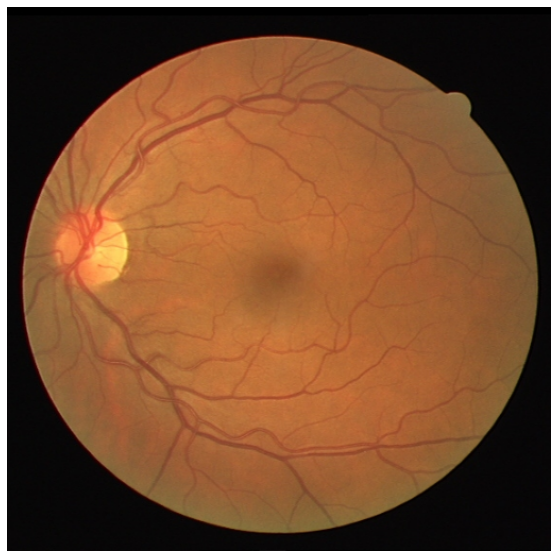

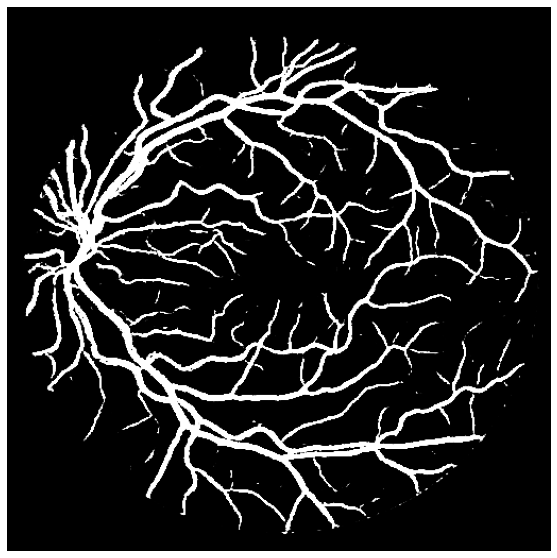

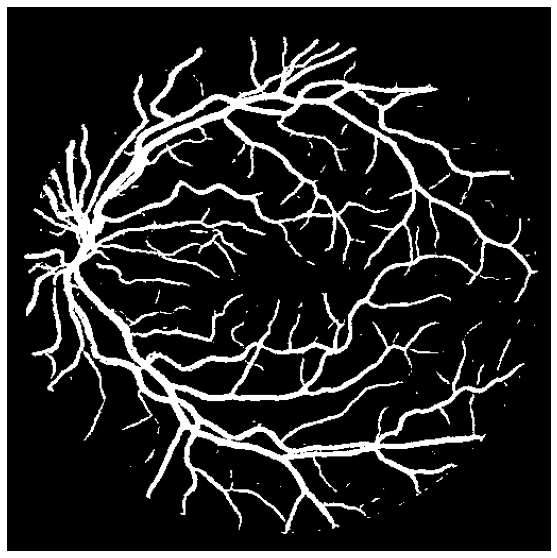

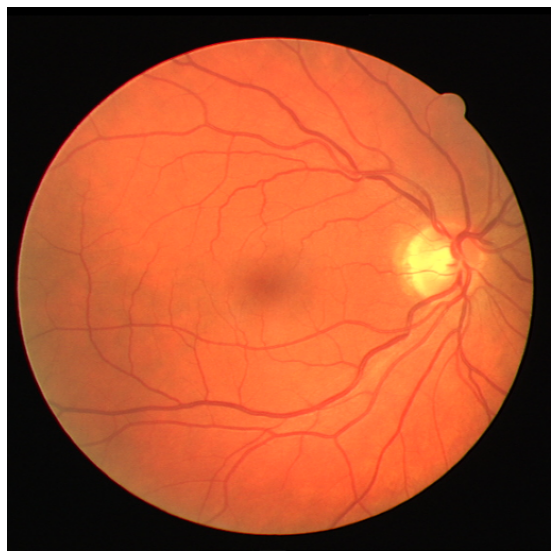

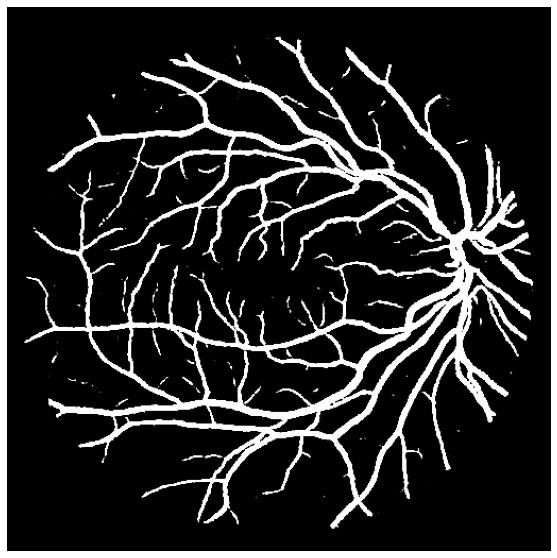

...

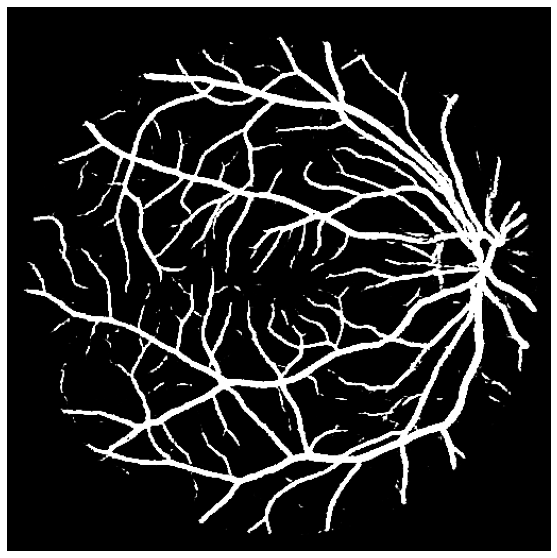

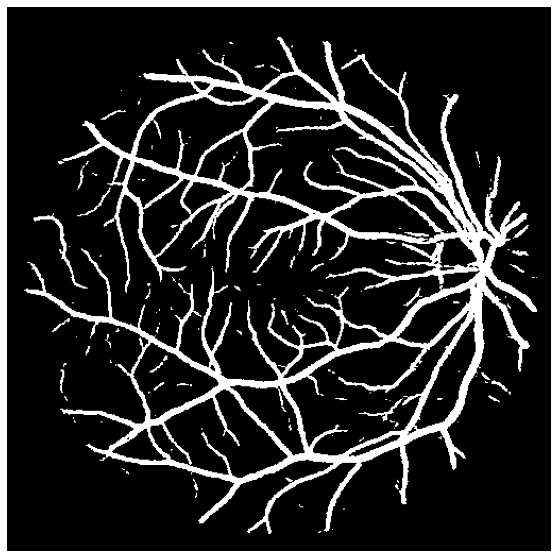

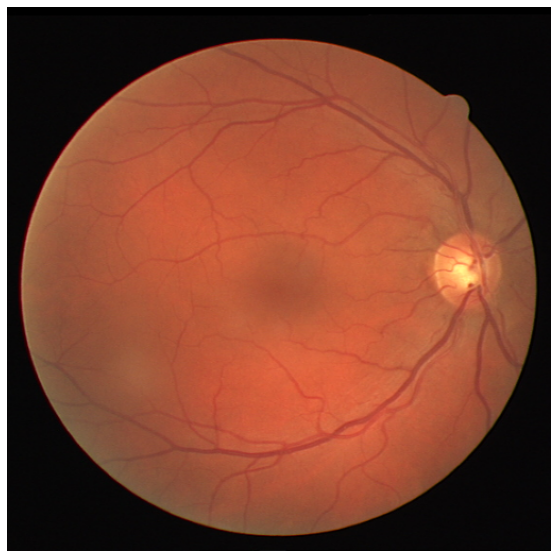

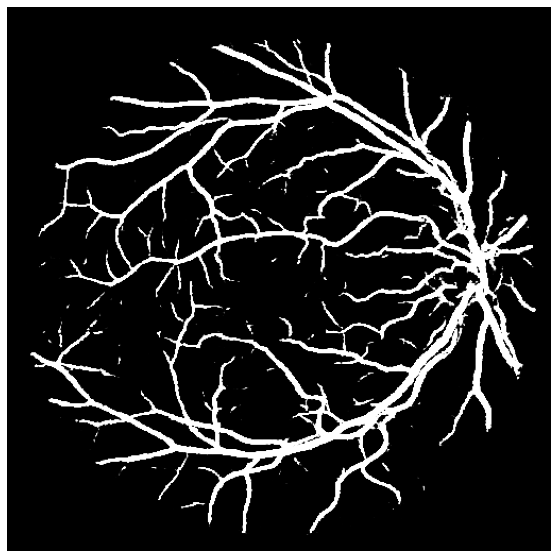

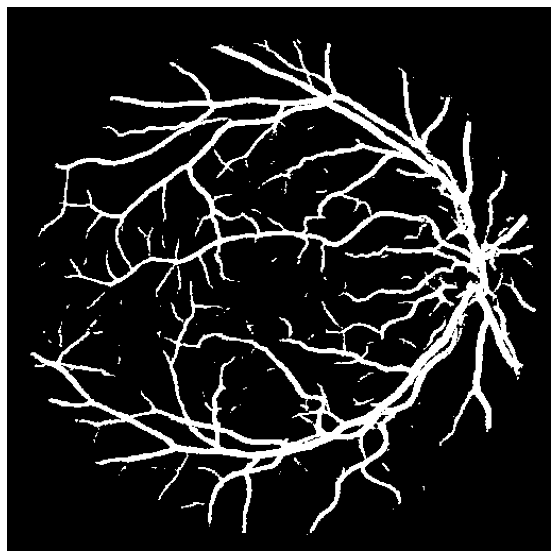

In [13]:
# Validação

for i in range(0, len(preds_val)):

    plt.figure(figsize = (10, 10))
    plt.axis("off")
    plt.imshow(X_test[i])
    plt.savefig("./ResultadosImages/Validacao/FigValid{}.png".format(i))
    plt.show()

    plt.figure(figsize = (10, 10))
    plt.axis("off")
    plt.imshow(preds_val[i], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Validacao/FigEffUnetPrediValid{}.png".format(i))
    plt.show()

    plt.figure(figsize = (10, 10))
    plt.axis("off")
    plt.imshow(preds_val_t[i], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Validacao/FigEffUnetPredTreshiValid{}.png".format(i))
    plt.show()